# _Transferencia de Estilo_ sobre sinusoides trackeadas

    * Técnica mixta (SMS + CNN)
    * Transformada SMS (Spectral Modelling Synthesis) 
    * Style Transfer con CNN sobre parte sinusoidal
    * Reconstrucción (sumando residuo)


In [667]:
# What version of Python do you have?
import sys

import pandas as pd
import sklearn as sk
import tensorflow as tf
import keras
import platform

print(f"Python Platform: {platform.platform()}")
print(f"Tensor Flow Version: {tf.__version__}")
print(f"Keras Version: {keras.__version__}")
print()
print(f"Python {sys.version}")
print(f"Pandas {pd.__version__}")
print(f"Scikit-Learn {sk.__version__}")
gpu = len(tf.config.list_physical_devices('GPU'))>0
print("GPU is", "available" if gpu else "NOT AVAILABLE")

Python Platform: macOS-13.5.1-arm64-arm-64bit
Tensor Flow Version: 2.13.0
Keras Version: 2.13.1

Python 3.10.12 | packaged by conda-forge | (main, Jun 23 2023, 22:41:52) [Clang 15.0.7 ]
Pandas 2.0.3
Scikit-Learn 1.3.0
GPU is available


In [668]:
import sys, os, functools, time

import numpy as np
import matplotlib.pyplot as plt

import librosa
import librosa.display
from IPython.display import Audio, display
from scipy.signal import hamming, triang, blackmanharris

from keras.preprocessing.image import load_img, save_img, img_to_array
import numpy as np
from scipy.optimize import fmin_l_bfgs_b
import time
import argparse

from keras.applications import vgg19
from keras import backend as K
# from pathlib import Path

%matplotlib inline

In [669]:
from keras.preprocessing.image import load_img, save_img, img_to_array

from scipy.optimize import fmin_l_bfgs_b
import time

from pathlib import Path

In [670]:
# Habilita compatiblidad hacia atrás
import tensorflow._api.v2.compat.v1 as tf
tf.compat.v1.disable_eager_execution()

In [671]:
%%skip
# mount your Google drive
from google.colab import drive
drive.mount('/content/drive')

%ls /content/drive/MyDrive/Colab\ Notebooks/cnn-style-transfer-2018
%cd /content/drive/MyDrive/Colab\ Notebooks/cnn-style-transfer-2018

UsageError: Cell magic `%%skip` not found.


In [672]:
# tmp
#import sys
#sys.path.append(os.path.join(os.path.dirname(os.path.realpath('__file__')), './transferencia-estilo-sms/'))
#sys.path.append(os.path.join(os.path.dirname(os.path.realpath('__file__')), '../'))
#sys.path.append(os.path.join(os.path.dirname(os.path.realpath('__file__')), '../sms-tools-lite/software/models/'))

In [673]:
from stft import *

# Métodos para plot en tiempo, espectrograma, sinusoides, etc
import visualizar

# Métodos para Análisis/Síntesis: SMS, STFT, Log STFT, etc

In [674]:
!git clone --depth=1 https://github.com/hordiales/sms-tools-lite

fatal: destination path 'sms-tools-lite' already exists and is not an empty directory.


In [675]:
# !ls

In [676]:
!git clone https://github.com/MTG/sms-tools

fatal: destination path 'sms-tools' already exists and is not an empty directory.


In [677]:
# ! pip install cython

In [678]:
# Sms-tools-lite (2018 version)
# !cd sms-tools-lite/software/models/utilFunctions_C && python3 compileModule.py build_ext --inplace

In [679]:
# Sms-Tools
# !cd sms-tools/software/models/utilFunctions_C && python compileModule.py build_ext --inplace

In [680]:
# Métodos para Análisis/Síntesis: SMS, STFT, Log STFT, etc
from sms import * # ModuleNotFoundError: No module named 'sineModel'

# check updated sms notebooks https://github.com/MTG/sms-tools/tree/master/notebooks

In [681]:
import tensorflow as tf
from sys import stderr


In [682]:
# PROC_DEVICE = '/cpu:0' # CPU processor
# PROC_DEVICE = '/gpu:0' # For GPU implementation

In [683]:
%%skip
# Now we will import tensorflow and we will use this library
# to build our model using the Keras API, and automatic differentiation

import tensorflow as tf

# you may also use a GPU if you have one available
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))
PROC_DEVICE = device_name

UsageError: Cell magic `%%skip` not found.


## Configuración / Hyperparámetros

In [684]:
MAX_NUM_SINES = 16

ALPHA= .9e-2
#ALPHA= .4e-2 # más estilo

MAX_ITER =300

N_FILTERS = 4096 # cantidad de filtros
BATCH_SIZE = 1 # batch size 
m = 1 # número de batch

FILTER_DIM = 11 # dimensión de los filtro

N_FFT = 2048 # cantidad de puntos de la fft

## Definición de estilo y contenido

In [685]:
#sys.path.append(os.path.join(os.path.dirname(os.path.realpath('__file__')), '../'))
# CONTENIDO_FILENAME = "extractos/ElChoclo_10s.wav"
# CONTENIDO_FILENAME = "extractos/relato-short.wav"
CONTENIDO_FILENAME = "extractos/relato-extract.wav"
CONTENIDO_FILENAME = "extractos/relato-alt.wav"
# ESTILO_FILENAME = "extractos/AdiosNonino_10s.wav"
#ESTILO_FILENAME = "extractos/tango-el-sueño-del-pibe.wav"
ESTILO_FILENAME = "extractos/tango-el-sueño-del-pibe-mono.wav" #archivo con los dos canales mixeados a mono

# SMS Análisis del Contenido ('El choclo')

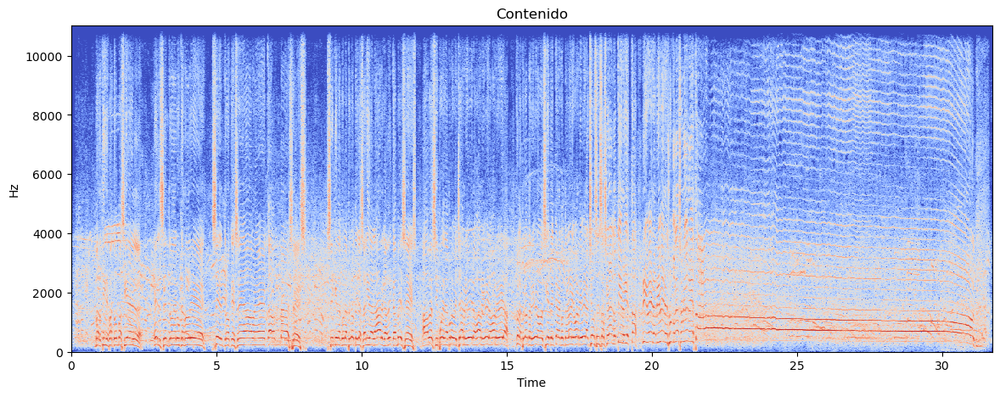

In [686]:
visualizar.espectrograma_grande(CONTENIDO_FILENAME, "Contenido")

In [687]:
import soundfile as sf

In [688]:
def sms_synth_to_file(output_filename, tfreq, tmag, tphase, Fs):
    """ 
        Synthesis from freq, mag and phase
        Writes to file
        Returns y: a vector with audio 
    """
    y = np.asarray( SM.sineModelSynth(tfreq, tmag, tphase, SMS.Ns, SMS.H, Fs), dtype='float32' )
    #librosa.output.write_wav(output_filename, y, Fs)
    sf.write(file=output_filename, data=y, samplerate=Fs)
    return y
#sms_synth_from_file()

In [689]:
# TODO: agregar generator?

In [690]:
CONTENIDO_RECONSTR_RESIDUO_ESTILO_FILENAME = "./sms_contenido_reconstruccion_residuo_estilo.wav"

In [691]:
#Contenido
tfreq, tmag, tphase, Fs = sms_analysis_from_file(CONTENIDO_FILENAME)
display(Audio(CONTENIDO_FILENAME), "Original")

#Sinusoides (del contenido)
CONTENIDO_SINUSOIDES_FILENAME = "contenido_sinusoides.wav"
y = sms_synth_to_file(CONTENIDO_SINUSOIDES_FILENAME, tfreq, tmag, tphase, Fs)

display(Audio(CONTENIDO_SINUSOIDES_FILENAME), "Sinusoides")

#Residuo
CONTENIDO_RESIDUAL_FILENAME = "./contenido_residual.wav"
x, Fs = librosa.load(CONTENIDO_FILENAME) #original
sinusoidal_part = np.concatenate([y, np.zeros(np.shape(x)[0]-np.shape(y)[0])]) # misma longitud para poder restar
residual = np.asarray( x-sinusoidal_part, dtype='float32' ) # original sound - sinusoidal part
#librosa.output.write_wav(CONTENIDO_RESIDUAL_FILENAME, residual, Fs)
sf.write(file=CONTENIDO_RESIDUAL_FILENAME, data=residual, samplerate=Fs)
    
display(Audio(CONTENIDO_RESIDUAL_FILENAME), "Residuo")

#Reconstrucción
CONTENIDO_RECONSTR_FILENAME = "./sms_contenido_reconstruccion_residuo_original.wav"
CONTENIDO_RECONSTR_RESIDUO_ESTILO_FILENAME = "./sms_contenido_reconstruccion_residuo_estilo.wav"
x_reconstr = np.asarray( sinusoidal_part+residual, dtype='float32' ) # original sound - sinusoidal part
#librosa.output.write_wav(CONTENIDO_RECONSTR_FILENAME, x_reconstr, Fs)
sf.write(file=CONTENIDO_RECONSTR_FILENAME, data=x_reconstr, samplerate=Fs)


display(Audio(CONTENIDO_RECONSTR_FILENAME), "Reconstrucción")

contenido_X_FRAMES = x.shape[0]

'Original'

'Sinusoides'

'Residuo'

'Reconstrucción'

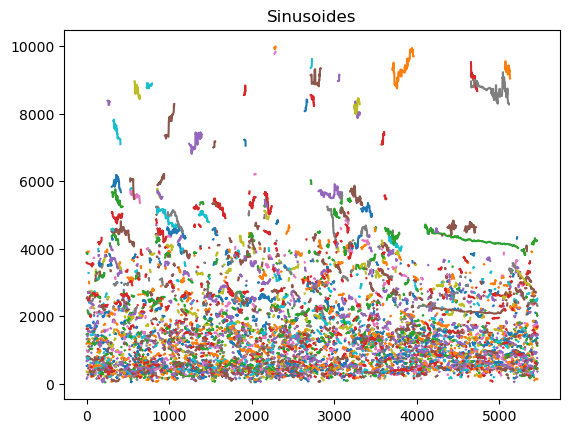

In [692]:
f_tmp = tfreq
f_tmp[f_tmp<=0] = None
for num in range(MAX_NUM_SINES):
    plt.plot(f_tmp[:,num], 'C'+str(num%10))
plt.title("Sinusoides")
plt.show()

# SMS análisis del estilo

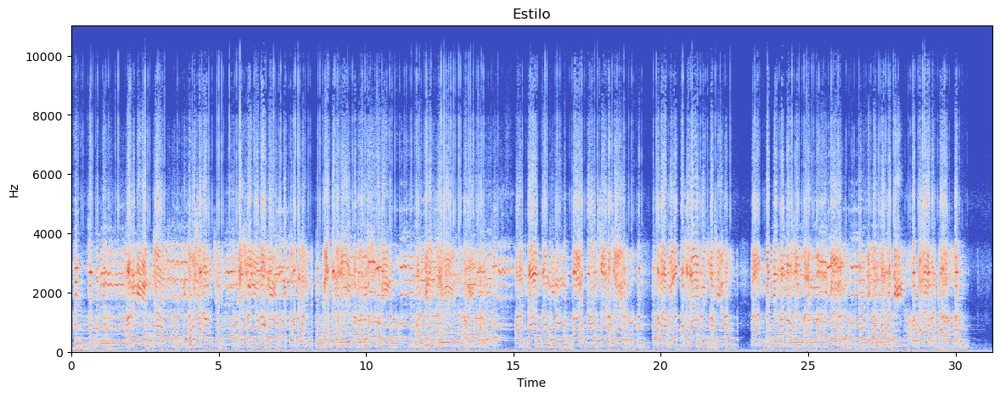

In [693]:
visualizar.espectrograma_grande(ESTILO_FILENAME, "Estilo")

In [694]:
tfreq, tmag, tphase, fs = sms_analysis_from_file(ESTILO_FILENAME)
display( Audio(ESTILO_FILENAME), "Original" )

#Sinusoides
ESTILO_SINUSOIDES_FILENAME = "estilo_sinusoides.wav"
y = sms_synth_to_file(ESTILO_SINUSOIDES_FILENAME, tfreq, tmag, tphase, Fs)

display(Audio(ESTILO_SINUSOIDES_FILENAME), "Sinusoides")

ESTILO_RESIDUAL_FILENAME = "./estilo_residual.wav"
x, Fs = librosa.load(ESTILO_FILENAME) #original
sinusoidal_part = np.concatenate([y, np.zeros(np.shape(x)[0]-np.shape(y)[0])]) # misma longitud para poder restar
residual = np.asarray( x-sinusoidal_part, dtype='float32' ) # original sound - sinusoidal part
#librosa.output.write_wav(ESTILO_RESIDUAL_FILENAME, residual, Fs)

sf.write(file=ESTILO_RESIDUAL_FILENAME, data=residual, samplerate=Fs)    

display(Audio(ESTILO_RESIDUAL_FILENAME), "Residuo")

#Reconstrucción
ESTILO_RECONSTR_FILENAME = "./sms_estilo_reconstruccion.wav"
x_reconstr = np.asarray( sinusoidal_part+residual, dtype='float32' ) # original sound - sinusoidal part
#librosa.output.write_wav(ESTILO_RECONSTR_FILENAME, x_reconstr, Fs)
sf.write(file=ESTILO_RECONSTR_FILENAME, data=x_reconstr, samplerate=Fs)    

display(Audio(ESTILO_RECONSTR_FILENAME), "Reconstrucción")

estilo_X_FRAMES = x.shape[0]

'Original'

'Sinusoides'

'Residuo'

'Reconstrucción'

# Comparativa de espectrogramas

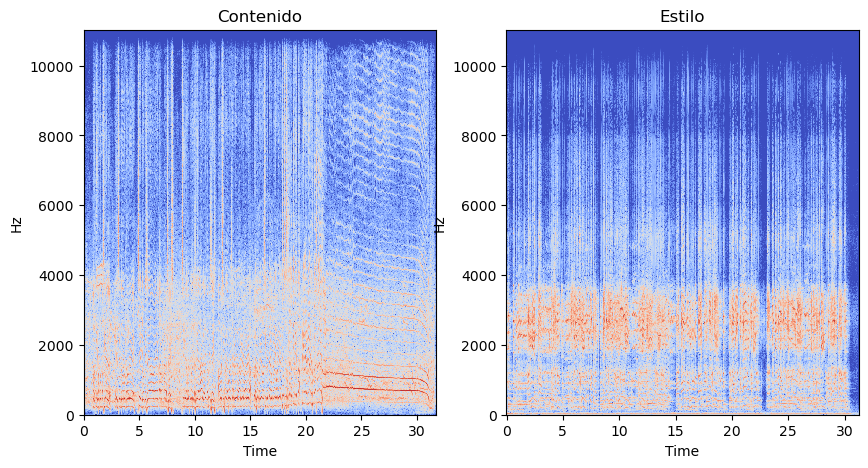

In [695]:
visualizar.comparar_espectrogramas_grande(CONTENIDO_FILENAME, "Contenido", ESTILO_FILENAME, "Estilo" )

In [696]:
N_SAMPLES = np.min([ contenido_X_FRAMES, estilo_X_FRAMES]) 

# Retorna solo el vector de magnitud (en escala logarítmica)
# audio_contenido y audio_estilo
a_contenido, Fs = logmag_stft_from_file(CONTENIDO_SINUSOIDES_FILENAME, X_FRAMES=N_SAMPLES, N_FFT=N_FFT)
a_estilo, Fs = logmag_stft_from_file(ESTILO_SINUSOIDES_FILENAME, X_FRAMES=N_SAMPLES)

N_SAMPLES = np.min([ a_contenido.shape[1], a_estilo.shape[1]]) 
N_HEIGHT = 1 # equivale al height de la imagen
N_CHANNELS = a_contenido.shape[0] # cantidad de muestras en frecuencia (channels) o columnas

# IMPORTANTE: se toman del estilo igual cantidad de samples y frecuencias que el contenido
a_estilo = a_estilo[:N_CHANNELS, :N_SAMPLES]
a_contenido = a_contenido[:N_CHANNELS, :N_SAMPLES]

Frames:  (1025, 1366)
Frames:  (1025, 1346)


In [697]:
assert(a_estilo.shape==a_contenido.shape)

In [698]:
a_contenido.shape

(1025, 1346)

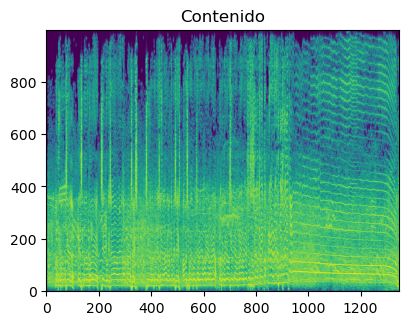

In [699]:
visualizar.espectrograma(librosa.amplitude_to_db(a_contenido),'Contenido')

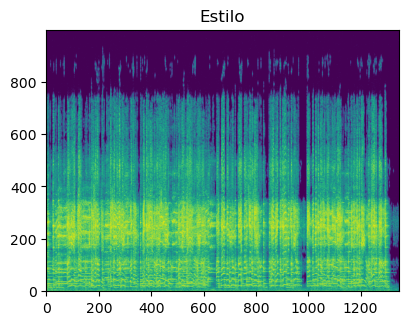

In [700]:
visualizar.espectrograma(librosa.amplitude_to_db(a_estilo),'Estilo')

------
# Nueva implementación
-------

In [701]:
# base_image_path = Path(CONTENIDO_FILENAME)
# style_reference_image_path = Path(ESTILO_FILENAME)
result_prefix = Path.cwd() / Path("output")


In [702]:
c_width, c_height = a_contenido.shape
s_width, s_height = a_estilo.shape
img_nrows = np.min( [c_width, s_width] ) # channels
img_ncols = np.min( [c_height, s_height] ) # frames
print(img_nrows, img_ncols)

1025 1346


In [703]:
#FIXME: se triplican los cálculos utilizando RGB (3 canales) cuando alcanza con uno solo
#TODO: revisar algoritmo para promediar pesos de 3 capas a una que se usa en keras / clasificación de audio multiclase (la otra notebook) 

def preprocess_image(input_2D_array):
    # Assuming img is the grayscale image with shape (1025, 433, 1)
    img = np.expand_dims(input_2D_array, axis=[2])

    # Repeat the grayscale image along the third axis to create a RGB image
    img_rgb = np.repeat(img, 3, axis=2)

    # print(img_rgb.shape)  # Output: (1025, 433, 3)

    # img = img_to_array(img)
    img_rgb = np.expand_dims(img_rgb, axis=0)
    img_rgb = vgg19.preprocess_input(img_rgb)
    return img_rgb

def deprocess_image(x):
    x = x.reshape((img_nrows, img_ncols, 3))
    # Remove zero-center by mean pixel
    x[:, :, 0] += 103.939
    x[:, :, 1] += 116.779
    x[:, :, 2] += 123.68
    # 'BGR'->'RGB'
    x = x[:, :, ::-1]
    x = np.clip(x, 0, 255).astype('uint8')
    return x

In [704]:
# get tensor representations of our images
# K.variable convierte un numpy array en un tensor, para 
base_image = K.variable(preprocess_image(a_contenido))
style_reference_image = K.variable(preprocess_image(a_estilo))

# Hiperparámetros

In [705]:
# total_variation_weight = 0.01
# total_variation_weight = 0.5
# total_variation_weight = 1000
total_variation_weight = 1
# total_variation_weight = 0.1

# style_weight = 5
# style_weight = 50
# style_weight = 1
# style_weight = 10
style_weight = 100
# style_weight = 100000000

# content_weight = 1
content_weight = 0.001
# content_weight = 10
# content_weight = 100

# iterations = 100
# iterations = 300
iterations = 5
iterations = 3
# iterations = 10


In [706]:
style_reference_image.shape

TensorShape([1, 1025, 1346, 3])

In [707]:
combination_image = K.placeholder((1, img_nrows, img_ncols, 3))
# combine the 3 images into a single Keras tensor
input_tensor = K.concatenate([base_image,
                              style_reference_image,
                              combination_image], axis=0)

In [708]:
# build the VGG19 network with our 3 images as input
# the model will be loaded with pre-trained ImageNet weights
model = vgg19.VGG19(input_tensor=input_tensor,
                    weights='imagenet', include_top=False)
print('Model loaded.')

# get the symbolic outputs of each "key" layer (we gave them unique names).
outputs_dict = dict([(layer.name, layer.output) for layer in model.layers])

2023-09-09 19:16:55.095786: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-09-09 19:16:55.217658: W tensorflow/c/c_api.cc:304] Operation '{name:'block3_conv1_11/bias/Assign' id:13229 op device:{requested: '', assigned: ''} def:{{{node block3_conv1_11/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](block3_conv1_11/bias, block3_conv1_11/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-09-09 19:16:55.505951: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


Model loaded.


2023-09-09 19:16:56.149165: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


In [709]:
# move all this to an external library

def gram_matrix(x):
    features = K.batch_flatten(K.permute_dimensions(x, (2, 0, 1)))
    gram = K.dot(features, K.transpose(features))
    return gram

def style_loss(style, combination):
    assert K.ndim(style) == 3
    assert K.ndim(combination) == 3
    S = gram_matrix(style)
    C = gram_matrix(combination)
    channels = 3
    size = img_nrows * img_ncols
    return K.sum(K.square(S - C)) / (4.0 * (channels ** 2) * (size ** 2))

def content_loss(base, combination):
    return K.sum(K.square(combination - base))

# Se define el 1.25 como constante (hyperparámetro)
def total_variation_loss(x):
    assert K.ndim(x) == 4
    a = K.square(
        x[:, :img_nrows - 1, :img_ncols - 1, :] - x[:, 1:, :img_ncols - 1, :])
    b = K.square(
        x[:, :img_nrows - 1, :img_ncols - 1, :] - x[:, :img_nrows - 1, 1:, :])
    return K.sum(K.pow(a + b, 1.25))


In [710]:
REF_BASE_IMG = 0
REF_STYLE_IMG = 1
REF_COMB_IMG = 2

# Armamos la loss total
loss = K.variable(0.0)

layer_features = outputs_dict['block5_conv2']

base_image_features = layer_features[REF_BASE_IMG, :, :, :]
combination_features = layer_features[REF_COMB_IMG, :, :, :]

loss = loss + content_weight * content_loss(base_image_features,combination_features)

feature_layers = ['block1_conv1', 'block2_conv1',
                  'block3_conv1', 'block4_conv1',
                  'block5_conv1']

for layer_name in feature_layers:
    layer_features = outputs_dict[layer_name]
    style_reference_features = layer_features[REF_STYLE_IMG, :, :, :] 
    combination_features = layer_features[REF_COMB_IMG, :, :, :]
    
    sl = style_loss(style_reference_features, combination_features)
    loss = loss + (style_weight / len(feature_layers)) * sl

loss = loss + total_variation_weight * total_variation_loss(combination_image)

In [711]:
grads = K.gradients(loss, combination_image)

outputs = [loss]
if isinstance(grads, (list, tuple)):
    outputs += grads
else:
    outputs.append(grads)

f_outputs = K.function([combination_image], outputs)

In [712]:
def eval_loss_and_grads(x):
    # Reshape the input image to match the expected input shape for the model
    x = x.reshape((1, img_nrows, img_ncols, 3))
    # Compute the loss and gradients for the input image
    outs = f_outputs([x])
    # Extract the loss value from the computed outputs
    loss_value = outs[0]
    # If there is only one gradient value, flatten it and convert to float64
    if len(outs[1:]) == 1:
        grad_values = outs[1].flatten().astype('float64')
    # If there are multiple gradient values, convert them to a flat numpy array of float64
    else:
        grad_values = np.array(outs[1:]).flatten().astype('float64')
    # Return the computed loss and gradient values
    return loss_value, grad_values

# this Evaluator class makes it possible
# to compute loss and gradients in one pass
# while retrieving them via two separate functions,
# "loss" and "grads". This is done because scipy.optimize
# requires separate functions for loss and gradients,
# but computing them separately would be inefficient.

In [713]:
class Evaluator(object):

    def __init__(self):
        self.loss_value = None
        self.grads_values = None

    def loss(self, x):
        assert self.loss_value is None
        loss_value, grad_values = eval_loss_and_grads(x)
        self.loss_value = loss_value
        self.grad_values = grad_values
        return self.loss_value

    def grads(self, x):
        assert self.loss_value is not None
        grad_values = np.copy(self.grad_values)
        self.loss_value = None
        self.grad_values = None
        return grad_values

In [714]:
FULLPATH_CONTENIDO_FILENAME = CONTENIDO_FILENAME
CONTENIDO_FILENAME = CONTENIDO_FILENAME.split("/")[1].split(".")[0]
FULLPATH_ESTILO_FILENAME = ESTILO_FILENAME
ESTILO_FILENAME = ESTILO_FILENAME.split("/")[1].split(".")[0]
print("Content:", CONTENIDO_FILENAME)
print("Style:", ESTILO_FILENAME)
print("total_variation_weight:", total_variation_weight)
print("style_weight:", style_weight)
print("content_weight:", content_weight)
print("Iterations:", iterations)

Content: relato-alt
Style: tango-el-sueño-del-pibe-mono
total_variation_weight: 1
style_weight: 100
content_weight: 0.001
Iterations: 3


In [715]:
BASEIMG = CONTENIDO_FILENAME.upper().split(".")[0]
STYLEIMG = ESTILO_FILENAME.upper().split(".")[0]
TOTALVARIATIONW = str(total_variation_weight)
STYLEW = str(style_weight)
CONTENTW = str(content_weight)
IT_NUMBER = str(1)
# print(f'output_{BASEIMG}_{STYLEIMG}_{TOTALVARIATIONW}_{STYLEW}_{CONTENTW}_at_iteration_{IT_NUMBER}.png')

In [716]:
#TODO: ver lo de early stopping, porque a partir de la iteración 10 casi no se notan diferencias
# probar con otros audios, el style transfer, etc

In [717]:
#código sin early stopping

evaluator = Evaluator() # 

# run scipy-based optimization (L-BFGS) over the pixels of the generated image
# so as to minimize the neural style loss
x = preprocess_image(a_contenido) #revisar

for i in range(iterations):
    print('Start of iteration', i)
    start_time = time.time()
    x, min_val, info = fmin_l_bfgs_b(evaluator.loss, x.flatten(),
                                     fprime=evaluator.grads, maxfun=20)
    print('Current loss value:', min_val)
    # save current generated image
    img = deprocess_image(x.copy())
    # fname = result_prefix / ('output_at_iteration_%d.png' % i)
    fname = result_prefix / (f'output_{BASEIMG}_{STYLEIMG}_{TOTALVARIATIONW}_{STYLEW}_{CONTENTW}_at_iteration_{i}.png')
    save_img(fname, img)

    #guardarlo siempre para poder cortar la interrupción?
    # if i==(iterations-1):
        # result = img
    result = img
        
    end_time = time.time()
    print('Image saved as', fname)
    print('Iteration %d completed in %ds' % (i, end_time - start_time))

Start of iteration 0


2023-09-09 19:17:01.408851: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-09-09 19:17:01.459011: W tensorflow/c/c_api.cc:304] Operation '{name:'Variable_30/Assign' id:13637 op device:{requested: '', assigned: ''} def:{{{node Variable_30/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](Variable_30, Variable_30/Initializer/initial_value)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-09-09 19:17:01.790893: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-09-09 19:17:01.912190: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enable

Current loss value: 3690342.2
Image saved as /Users/hordia/dev/ML/transferencia-estilo-sms/output/output_RELATO-ALT_TANGO-EL-SUEÑO-DEL-PIBE-MONO_1_100_0.001_at_iteration_0.png
Iteration 0 completed in 65s
Start of iteration 1
Current loss value: 1104941.5
Image saved as /Users/hordia/dev/ML/transferencia-estilo-sms/output/output_RELATO-ALT_TANGO-EL-SUEÑO-DEL-PIBE-MONO_1_100_0.001_at_iteration_1.png
Iteration 1 completed in 61s
Start of iteration 2
Current loss value: 607393.56
Image saved as /Users/hordia/dev/ML/transferencia-estilo-sms/output/output_RELATO-ALT_TANGO-EL-SUEÑO-DEL-PIBE-MONO_1_100_0.001_at_iteration_2.png
Iteration 2 completed in 59s



In this modified code, the best_loss variable is initialized with a very large value (float('inf')) at the beginning. After each iteration, the current loss value is compared with the best_loss. If the current loss is better (lower) than the best_loss, the best_loss is updated and the no_improvement_count is reset to 0. If the current loss is not better, the no_improvement_count is incremented. If the no_improvement_count reaches the patience value (in this case, 5), the loop is stopped, and the early stopping condition is triggered.

You can adjust the patience value according to your needs. A higher value will allow more iterations without improvement before stopping, while a lower value will stop the loop earlier.

In [718]:
%%skip
#FIXME: versión con early-stopping (no fucionar, revisar)

best_loss = float('inf')  # initialize the best loss value
patience = 5  # number of iterations to wait for improvement
no_improvement_count = 0  # counter for iterations without improvement

evaluator = Evaluator() # 

for i in range(iterations):
    print('Start of iteration', i)
    start_time = time.time()
    x, min_val, info = fmin_l_bfgs_b(evaluator.loss, x.flatten(),
                                     fprime=evaluator.grads, maxfun=20)
    print('Current loss value:', min_val)
    # save current generated image
    img = deprocess_image(x.copy())
    fname = result_prefix / (f'output_{BASEIMG}_{STYLEIMG}_{TOTALVARIATIONW}_{STYLEW}_{CONTENTW}_at_iteration_{i}.png')
    save_img(fname, img)
    if i == (iterations - 1):
        result = img
    end_time = time.time()
    print('Image saved as', fname)
    print('Iteration %d completed in %ds' % (i, end_time - start_time))

    # Check for early stopping
    if min_val < best_loss:
        best_loss = min_val
        no_improvement_count = 0
    else:
        no_improvement_count += 1
        if no_improvement_count >= patience:
            print('Early stopping at iteration', i)
            break

UsageError: Cell magic `%%skip` not found.


In [719]:
result.shape

(1025, 1346, 3)

In [720]:
# result = result[:,:,1] # se elimina las 3 capas rgb duplicadas (vale la pena promediar?)
result = np.mean(result, axis=2) # se elimina la capa promediando valores del resto

# Inversión del espectrograma de las sinusoides con estilo aplicado

    * Algoritmo de Griffin-Lim para reconstruir la fase
    * exp(val) -1, porque antes se toma log+1 de la magnitud

In [721]:
a_contenido.shape

(1025, 1346)

In [722]:
result.shape

(1025, 1346)

In [723]:
def reconstruccion_fase_griffin_lim(result, a_content, N_FFT=2048):
    """
        Reconstrucción utilizando el algoritmo de Griffin Lim

        Nota: Es medio lento... Ver el tema de número de iteraciones (500)
        Toma como base y referencia el contenido
    """
    ITERACIONES = 500
    a = np.zeros_like(a_content)

    # Dimension adjust
    # N_CHANNELS = np.min( [a_content.shape[0], result.shape[3]] ) # imple TF1
    N_CHANNELS = np.min( [a_content.shape[0], result.shape[0]] )
    N_FRAMES = np.min( [a_content.shape[1], result.shape[1]] )
   

    # a[:N_CHANNELS,:N_FRAMES] = (np.exp(result[0,0].T) - 1)[:N_CHANNELS,:N_FRAMES] # imple TF1
    a[:N_CHANNELS,:N_FRAMES] = (np.exp(result) - 1)[:N_CHANNELS,:N_FRAMES]
    

    p = 2 * np.pi * np.random.random_sample(a.shape) - np.pi

    for i in range(ITERACIONES):
        S = a * np.exp(1j*p)
        x = librosa.istft(S)
        p = np.angle(librosa.stft(x, n_fft=N_FFT))

    return x

In [724]:
result.T.shape

(1346, 1025)

In [725]:
N_CHANNELS

1025

In [726]:
x = reconstruccion_fase_griffin_lim(result, a_contenido)

In [727]:
OUTPUT_FILENAME = 'sinusoides_out.wav'

# librosa.output.write_wav(OUTPUT_FILENAME, x, fs) # old version
sf.write(file=OUTPUT_FILENAME, data=x, samplerate=fs)

# Primera reconstrucción (sin residuo)

In [728]:
sinusoidal_part = x
display(Audio(OUTPUT_FILENAME), "Reconstruido (sin residuo)")

'Reconstruido (sin residuo)'

In [729]:
CONTENIDO_FILENAME

'relato-alt'

# Reconstrucción con residuo original

In [730]:
residual, Fs = librosa.load(CONTENIDO_RESIDUAL_FILENAME)
residual_estilo, Fs = librosa.load(ESTILO_RESIDUAL_FILENAME)

K_len = np.min([ sinusoidal_part.shape[0],residual.shape[0], residual_estilo.shape[0] ])
print("Frames: ",K_len)

CONTENIDO_RECONSTR_FILENAME = "contenido_estilo_sobre_sinusoides_con_residuo_original.wav"

# se agrega solo el residuo original
x_reconstr = np.asarray( sinusoidal_part[:K_len]+residual[:K_len], dtype='float32' ) # original sound - sinusoidal part



# librosa.output.write_wav(CONTENIDO_RECONSTR_FILENAME, x_reconstr, Fs)
sf.write(file=CONTENIDO_RECONSTR_FILENAME, data=x_reconstr, samplerate=Fs)

    
display( Audio(FULLPATH_CONTENIDO_FILENAME), "Original")
display( Audio(FULLPATH_ESTILO_FILENAME), "Estilo")
display( Audio(CONTENIDO_RECONSTR_FILENAME), "Reconstrucción con estilo aplicado y residuo original")
display( Audio(OUTPUT_FILENAME), "Reconstruido (sin residuo)")

Frames:  688640


'Original'

'Estilo'

'Reconstrucción con estilo aplicado y residuo original'

'Reconstruido (sin residuo)'

In [731]:
print(CONTENIDO_RECONSTR_RESIDUO_ESTILO_FILENAME)

./sms_contenido_reconstruccion_residuo_estilo.wav


In [732]:
# con residuo del estilo
# residual_estilo
x_reconstr = np.asarray( sinusoidal_part[:K_len]+residual_estilo[:K_len], dtype='float32' ) # original sound - sinusoidal part

# librosa.output.write_wav(CONTENIDO_RECONSTR_FILENAME, x_reconstr, Fs)
sf.write(file=CONTENIDO_RECONSTR_RESIDUO_ESTILO_FILENAME, data=x_reconstr, samplerate=Fs)

    

display( Audio(CONTENIDO_RECONSTR_RESIDUO_ESTILO_FILENAME), "Reconstrucción con estilo aplicado y residuo del estilo (sin style transfer)")


'Reconstrucción con estilo aplicado y residuo del estilo (sin style transfer)'

# Espectrogramas finales

Frames:  (1025, 1346)


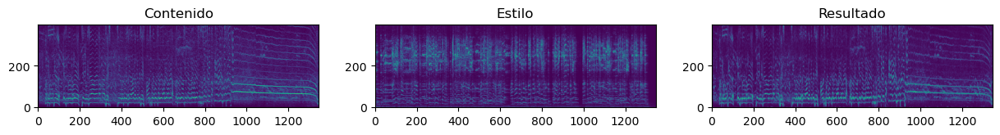

In [733]:
a_recon, Fs = logmag_stft_from_file(CONTENIDO_RECONSTR_FILENAME, X_FRAMES=N_SAMPLES)
visualizar.comparar_3_espectrogramas(a_contenido, a_estilo, a_recon, MAX_FREC_BINS=400)

# Conclusiones preliminares
   
    * Bien _mezclado_ (contenido y estilo)
    * Se percibe de baja calidad
    * Opcional sumar residuo original y/o el del estilo
    * Resultado similar al obtenido aplicando la STFT a todo el archivo, pero un parámetro más de configuración